In [1]:
# Install libraries
#!pip install osmnx geopandas pandas requests descartes contextily

In [92]:
import numpy as np
import pandas as pd 
import geopandas as gpd
import matplotlib.pyplot as plt
import osmnx as ox
import networkx as nx
from descartes import PolygonPatch
from shapely.geometry import Point, Polygon, MultiPolygon, LineString
from tqdm.auto import tqdm
import shapely.speedups
shapely.speedups.enable() 
import warnings
warnings.filterwarnings('ignore')
from matplotlib.patches import PathPatch
from matplotlib.path import Path

In [93]:
PLACE_NAME = 'Rome, Italy'
name = 'Rome'
grid_size = 500

Original CRS: epsg:4326
Projected CRS: EPSG:32633


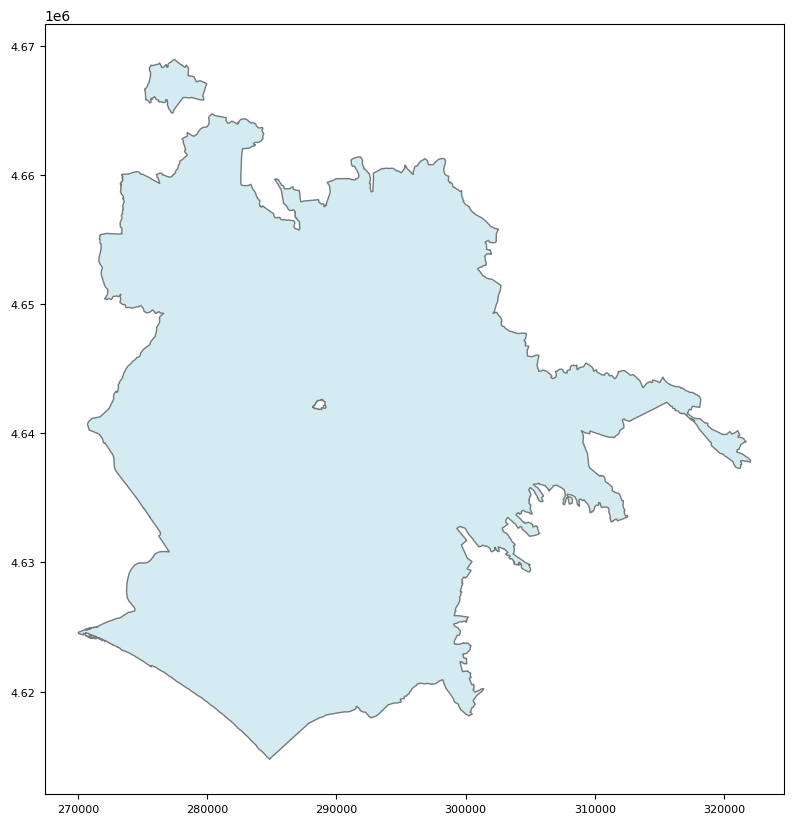

Bounds: [ 270025.02365398 4614769.70790613  322062.36286366 4668944.73568855]


In [94]:
city = ox.geocode_to_gdf(PLACE_NAME)
print("Original CRS:", city.crs)

# Change CRS for better handling of grid division, distances, etc.
city = ox.project_gdf(city)
print("Projected CRS:", city.crs)

# Plot and store the axis object
fig, ax = plt.subplots(figsize=(10, 10))
city.plot(ax=ax, color='lightblue', edgecolor='black', alpha=0.5)
ax.tick_params(axis='both', which='major', labelsize=8)
plt.show()

# Extract bounding box from city
bounds = city.total_bounds
print("Bounds:", bounds)
min_x, min_y, max_x, max_y = bounds

epsg:4326
EPSG:32633


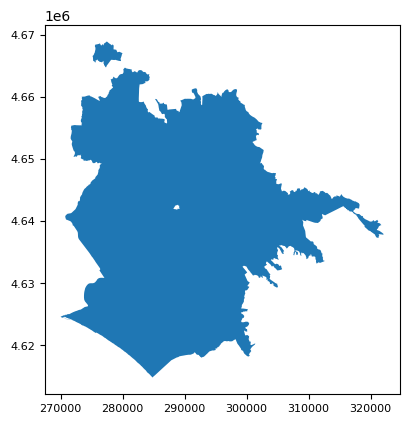

<class 'shapely.geometry.multipolygon.MultiPolygon'>


In [ ]:
#city = ox.geocode_to_gdf(PLACE_NAME)
#print(city.crs)
# changing CRS for grid division
#city = ox.project_gdf(city) 
#print(city.crs)

# Plot and store the axis object
#ax = city.plot()

# Customize the font size of the tick labels on the axes
#ax.tick_params(axis='both', which='major', labelsize=8)

# Display the plot
#plt.show()

# Print the type of geometry for your information
#geometry = city['geometry'].iloc[0]
#print(type(geometry))

In [95]:
#save geometry
city.to_file(f"D:/charging_stations/task2/map/{name}.shp")

# Division into grid

In [96]:
geometry_cut = ox.utils_geo._quadrat_cut_geometry(geometry, quadrat_width=grid_size) #500 Meter grid
print(type(geometry_cut))
polylist = [poly for poly in geometry_cut.geoms]

<class 'shapely.geometry.multipolygon.MultiPolygon'>


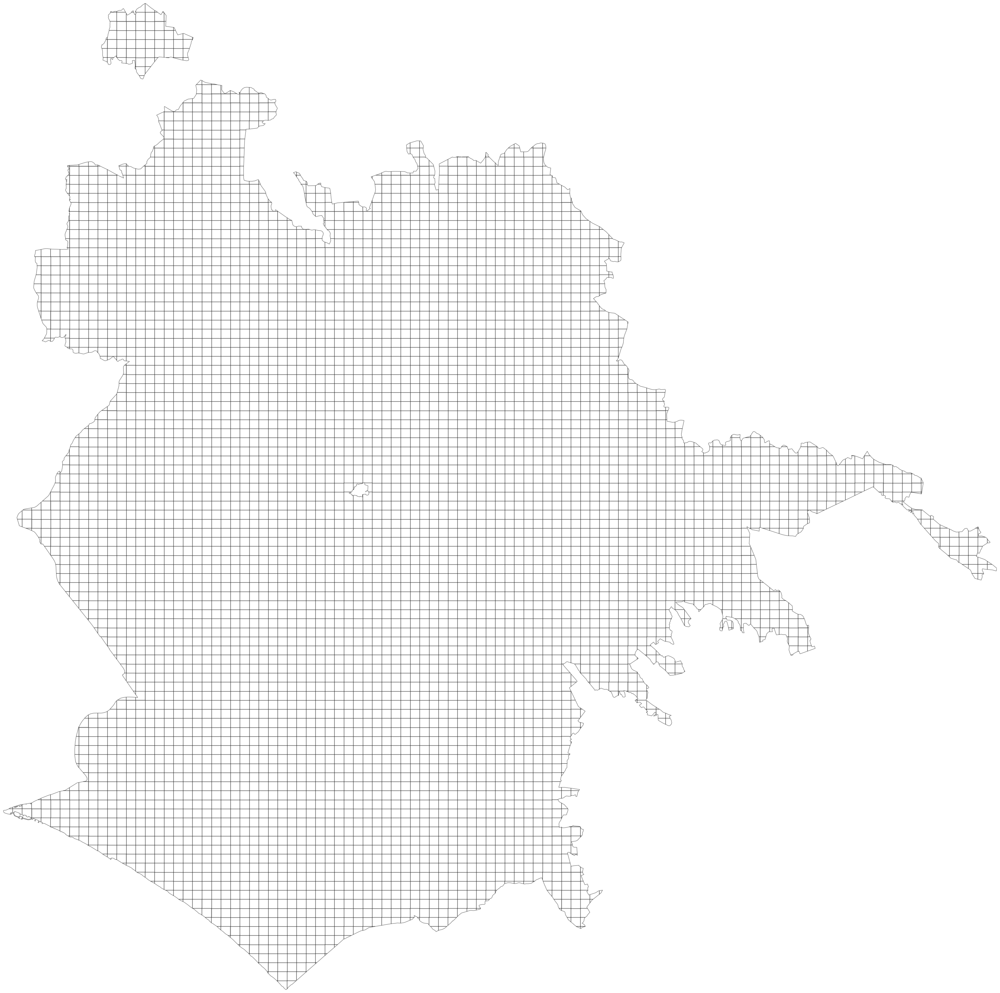

In [97]:
import shapely.geometry as sg
polylist = [poly for poly in geometry_cut.geoms]
# plot city
west, south, east, north = city.unary_union.bounds

# Manual patch creation
fig, ax = plt.subplots(figsize=(40, 40))
for polygon in geometry_cut.geoms:
    if isinstance(polygon, sg.Polygon) and not polygon.is_empty:
        verts = np.array(polygon.exterior.coords)
        codes = np.full(len(verts), Path.LINETO)
        codes[0] = Path.MOVETO
        codes[-1] = Path.CLOSEPOLY
        path = Path(verts, codes)
        patch = PathPatch(path, facecolor='white', edgecolor='black', alpha=0.5)
        ax.add_patch(patch)

ax.set_xlim(west, east)
ax.set_ylim(south, north)
ax.axis('off')
plt.show()

In [98]:
city_polyframe = gpd.GeoDataFrame(geometry=polylist)
city_polyframe.crs = city.crs
print(city_polyframe.crs)
city_polyframe.head()

EPSG:32633


,geometry
0,"POLYGON ((270025.024 4624611.066, 270085.665 4..."
1,"POLYGON ((270329.104 4624710.080, 270335.189 4..."
2,"POLYGON ((270520.617 4624792.210, 270527.065 4..."
3,"POLYGON ((271016.211 4624710.080, 271016.211 4..."
4,"POLYGON ((270862.697 4624213.061, 270867.628 4..."


(5109535.004510657, 5182128.295160213)

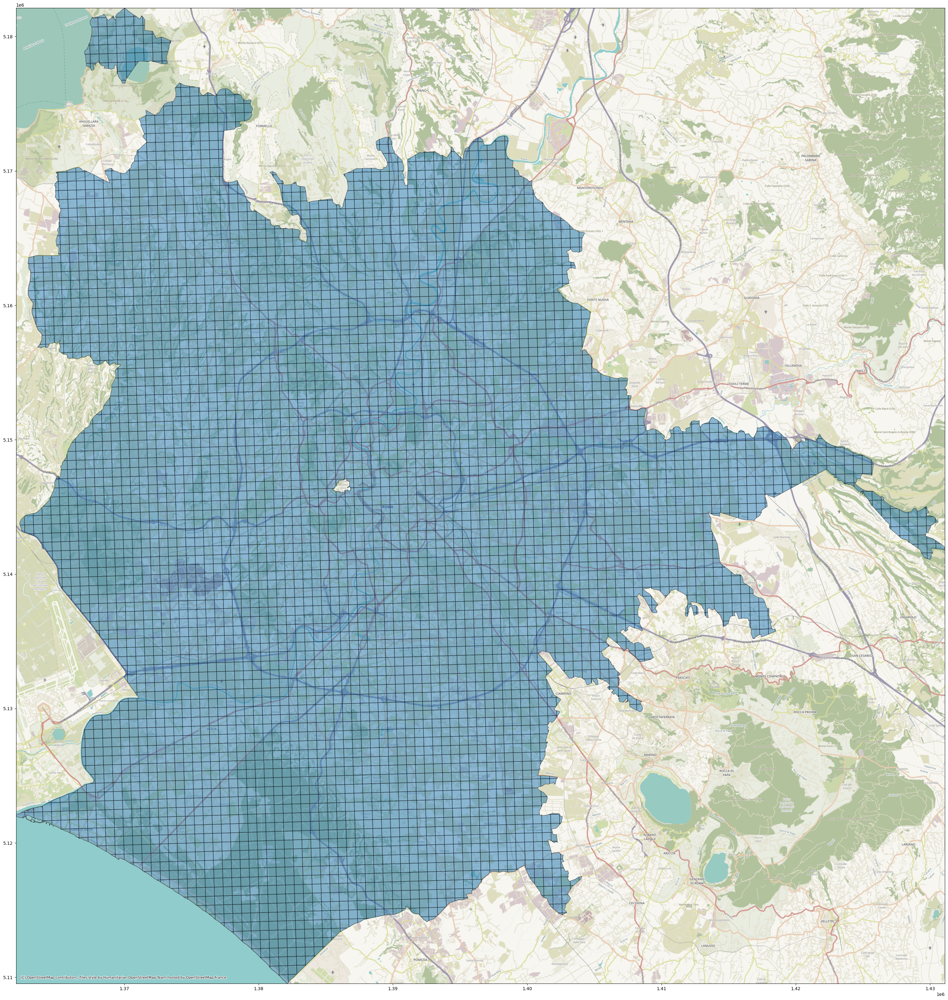

In [99]:
import contextily as ctx
# ctx uses epsg:3857ax = city.plot()
polyframe_3857 = city_polyframe.to_crs(epsg=3857)
west, south, east, north = polyframe_3857.unary_union.bounds

ax = polyframe_3857.plot(figsize=(40,40), alpha=0.5, edgecolor='k')
ctx.add_basemap(ax, zoom=13)
ax.set_xlim(west, east)
ax.set_ylim(south, north)

# POIs

In [100]:
city_polyframe_lat_long = ox.project_gdf(city_polyframe, to_latlong=True) #Changing CRS to (Lat, long)
city_polyframe_lat_long.head()

,geometry
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020..."
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106..."
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184..."
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832..."
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667..."


## EV station

In [142]:
EV_stations = pd.read_csv("D://charging_stations//task2//dataset//roma_ev_stations.csv")

In [143]:
EV_stations.head()

,locationId,businessName,status,capabilities,geometry
0,65fd53fa8855216dbbc0f970,NEOGY SRL,AVAILABLE,"['UNLOCK_CAPABLE', 'RFID_READER', 'RESERVABLE'...",POINT (12.410162 41.821767)
1,65fd53fc8855216dbbc0f972,NEOGY SRL,AVAILABLE,"['UNLOCK_CAPABLE', 'RFID_READER', 'RESERVABLE'...",POINT (12.406493 41.822332)
2,65fd53fa8855216dbbc0f970,NEOGY SRL,AVAILABLE,"['UNLOCK_CAPABLE', 'RFID_READER', 'RESERVABLE'...",POINT (12.410162 41.821767)
3,65fd53f68855216dbbc0f96c,NEOGY SRL,AVAILABLE,"['UNLOCK_CAPABLE', 'RFID_READER', 'RESERVABLE'...",POINT (12.409695 41.821698)
4,65fd53fb8855216dbbc0f971,NEOGY SRL,AVAILABLE,"['UNLOCK_CAPABLE', 'RFID_READER', 'RESERVABLE'...",POINT (12.406256 41.822261)


In [144]:
list(EV_stations.columns)

['locationId', 'businessName', 'status', 'capabilities', 'geometry']

In [145]:
import geopandas as gpd
from shapely import wkt
import pandas as pd

# Assuming EV_stations is loaded as a regular DataFrame and 'geometry' column is a string of WKT (Well-Known Text)
if not isinstance(EV_stations, gpd.GeoDataFrame):
    # Convert 'geometry' column from WKT string to Shapely Geometry objects
    EV_stations['geometry'] = EV_stations['geometry'].apply(wkt.loads)
    
    # Now convert DataFrame to GeoDataFrame
    EV_stations = gpd.GeoDataFrame(EV_stations, geometry='geometry')

# Set the CRS if it's not already set
if EV_stations.crs is None:
    EV_stations.set_crs("EPSG:4326", inplace=True)

Text(0.5, 1.0, 'Rome EV stations')

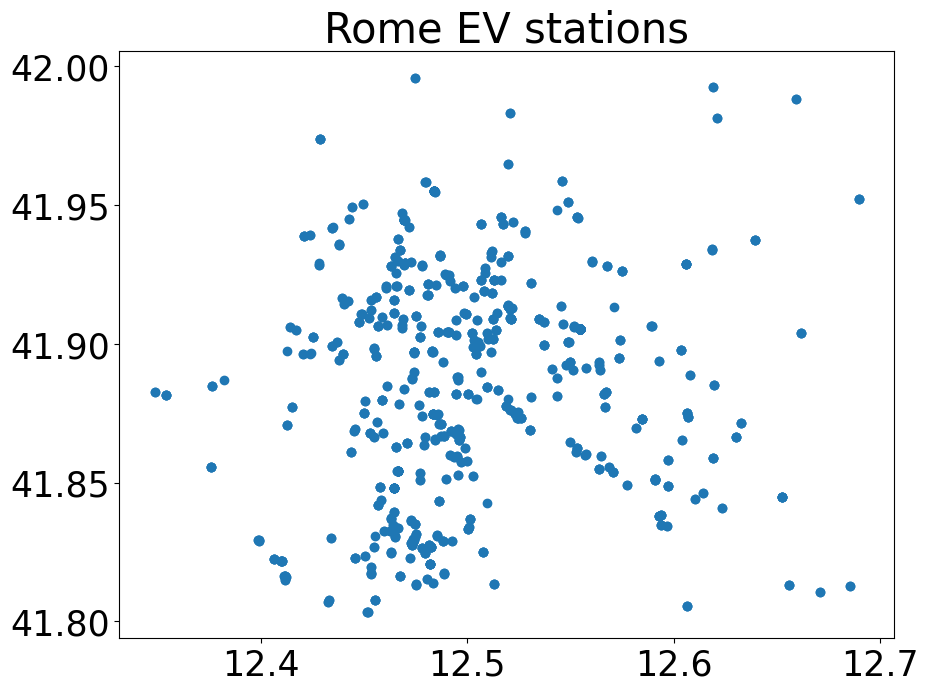

In [146]:
#plot EV stations geo data
EV_stations.plot(figsize=(10,10))
plt.title("Rome EV stations")

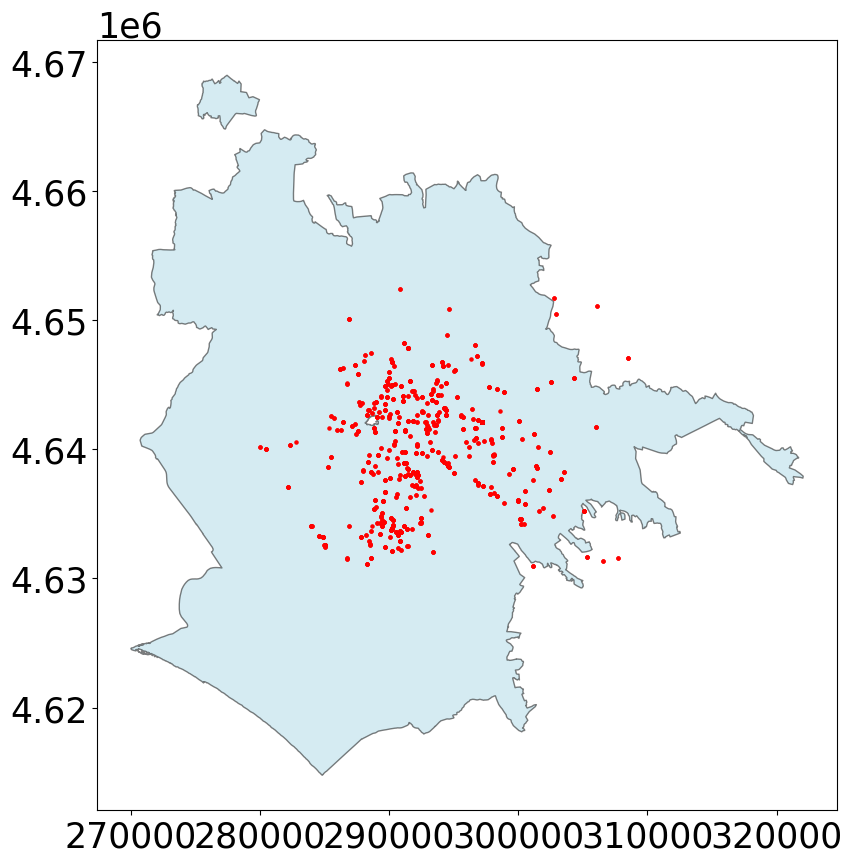

In [147]:
# Convert EV_stations to the same CRS as the city
EV_stations = EV_stations.to_crs(city.crs)

# Filter EV_stations based on the city bounds
filtered_EV_stations = EV_stations.cx[min_x:max_x, min_y:max_y]

# Plotting to verify the filtered data
fig, ax = plt.subplots(figsize=(10, 10))
city.plot(ax=ax, color='lightblue', edgecolor='black', alpha=0.5)
filtered_EV_stations.plot(ax=ax, marker='o', color='red', markersize=5)
plt.show()

In [149]:
#intersection of points and polygons
import shapely.speedups
shapely.speedups.enable() 

masks_EV = []
for i in tqdm(range(0,city_polyframe.shape[0])):
    pip_mask = EV_stations.within(city_polyframe_lat_long.loc[i, 'geometry']) 
    masks_EV.append(pip_mask)

  0%|          | 0/5649 [00:00<?, ?it/s]

100%|██████████| 5649/5649 [00:00<00:00, 12102.19it/s]


In [ ]:
# create a new geodataframe with mask EV stations 
#EV_stations_masked = gpd.GeoDataFrame()
#for i in tqdm(range(0,city_polyframe.shape[0])):
#    EV_stations_masked = pd.concat([EV_stations_masked, EV_stations[masks_EV[i]][['geometry']]], ignore_index=True)

100%|██████████| 5649/5649 [00:03<00:00, 1524.42it/s]


In [153]:
filtered_frames = [EV_stations[masks_EV[i]][['geometry']] for i in tqdm(range(city_polyframe.shape[0]))]
EV_stations_masked = pd.concat(filtered_frames, ignore_index=True)

100%|██████████| 5649/5649 [00:02<00:00, 1911.21it/s]


In [154]:
rome_polyframe_lat_long_new = city_polyframe_lat_long.copy()
rome_polyframe_lat_long_new['EV_stations_counts'] = 0
rome_polyframe_lat_long_new['EV_stations_geometry'] = None

In [155]:
from shapely.ops import unary_union
# Assuming EV stations are points and unary_union does not throw due to incompatible geometry types
union_geom = unary_union(EV_stations[masks_EV[i]]['geometry'].tolist())
rome_polyframe_lat_long_new.loc[i, 'EV_stations_geometry'] = union_geom

In [ ]:
#for i in tqdm(range(0,rome_polyframe_lat_long_new.shape[0])):
#    rome_polyframe_lat_long_new.loc[i, 'EV_stations_counts'] = EV_stations[masks_EV[i]].shape[0]
#    rome_polyframe_lat_long_new.loc[i, 'EV_stations_geomery'] = str(EV_stations[masks_EV[i]][['geometry']].values.tolist())

100%|██████████| 5649/5649 [00:05<00:00, 1086.66it/s]


In [156]:
#How many EV stations in each grid
rome_polyframe_lat_long_new['EV_stations_counts'].value_counts()
#Percentage of EV stations in each grid
rome_polyframe_lat_long_new['EV_stations_counts'].value_counts() / rome_polyframe_lat_long_new.shape[0]

EV_stations_counts
0    1.0
Name: count, dtype: float64

In [136]:
unique_ev_counts = rome_polyframe_lat_long_new['EV_stations_counts'].unique()

In [137]:
unique_ev_counts

array([0], dtype=int64)

In [134]:
rome_polyframe_lat_long_new.head(10)

,geometry,EV_stations_counts,EV_stations_geometry
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020...",0,None
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106...",0,None
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184...",0,None
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832...",0,None
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667...",0,None
5,"POLYGON ((12.24625 41.74332, 12.24637 41.74333...",0,None
6,"POLYGON ((12.25229 41.74137, 12.25248 41.73689...",0,None
7,"POLYGON ((12.25248 41.73689, 12.25250 41.73629...",0,None
8,"POLYGON ((12.24676 41.73676, 12.24674 41.73680...",0,None
9,"POLYGON ((12.25217 41.74424, 12.25405 41.74515...",0,None


## Population data visualize and add to each grid

In [115]:
df_pop = pd.read_csv("D:/charging_stations/task2/dataset/ita_general_2020.csv")
gdf = gpd.GeoDataFrame(df_pop, geometry=gpd.points_from_xy(df_pop.longitude, df_pop.latitude))

In [116]:
df_pop.head()

,longitude,latitude,ita_general_2020
0,6.215694,48.000139,1.061017
1,6.216250,48.000139,1.061017
2,6.216528,48.000139,1.061017
3,6.243750,48.000139,0.831058
4,6.244028,48.000139,0.831058


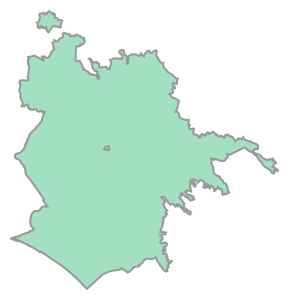

In [117]:
#extract population data for Rome
city.geometry[0]

In [118]:
# change crs to lat long
city_lat_long = ox.project_gdf(city, to_latlong=True)
pip_mask = gdf.within(city_lat_long.loc[0, 'geometry'])

In [119]:
rome_pop_gdf = gdf.loc[pip_mask]

<Axes: >

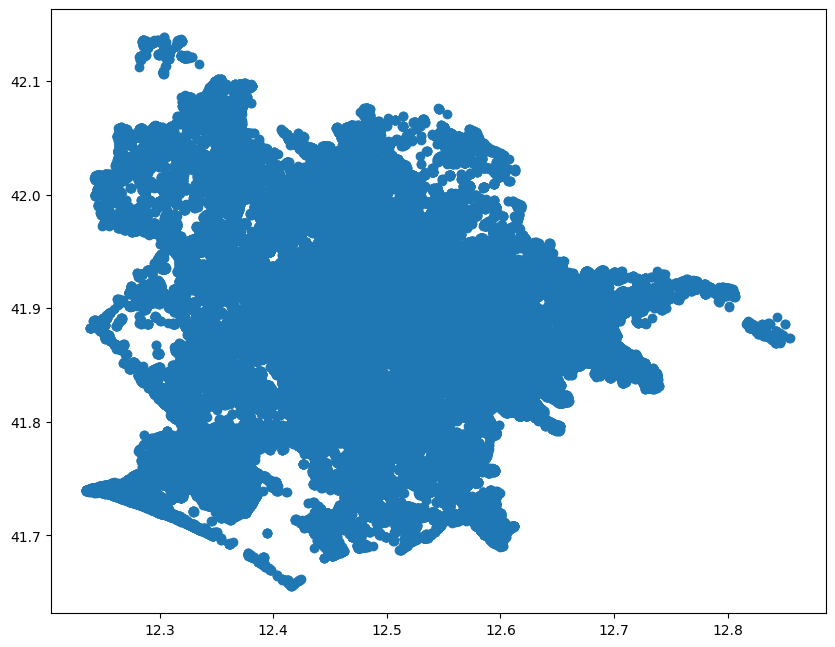

In [120]:
#plot population data with cmap
rome_pop_gdf.plot(figsize=(10,10))

In [121]:
rome_pop_gdf.to_csv(f"D:/charging_stations/task2/dataset/{name}-population.csv")

In [122]:
# population for each grid
masks_pop = []
for i in tqdm(range(0,city_polyframe_lat_long.shape[0])):
    pip_mask = rome_pop_gdf.within(city_polyframe_lat_long.loc[i, 'geometry'])
    masks_pop.append(pip_mask)

100%|██████████| 5649/5649 [01:44<00:00, 54.12it/s]


In [123]:
pop_grid = []
for i in range(0,city_polyframe_lat_long.shape[0]):
    pop_grid.append(rome_pop_gdf.loc[masks_pop[i]].ita_general_2020.mean())

In [124]:
pop_grid = np.nan_to_num(pop_grid)

In [125]:
rome_polyframe_lat_long_new['population'] = pop_grid
rome_polyframe_lat_long_new.head()

,geometry,EV_stations_counts,EV_stations_geomery,population
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020...",0,[],1.876362
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106...",0,[],1.394988
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184...",0,[],1.531297
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832...",0,[],1.561379
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667...",0,[],0.000000


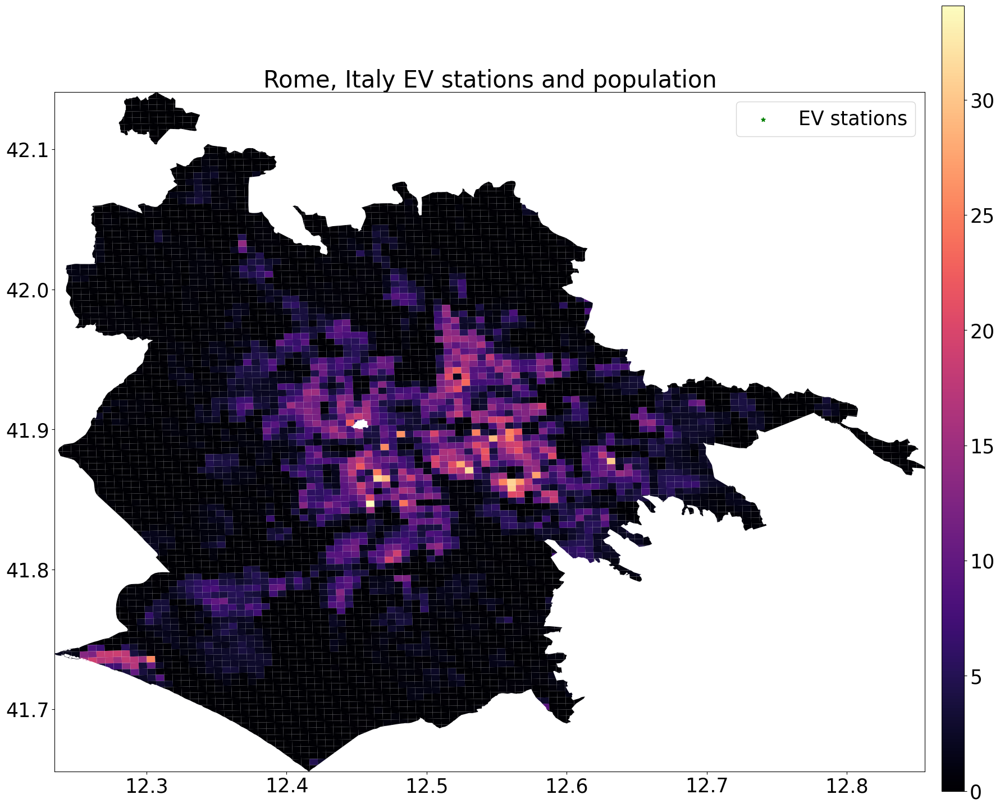

In [127]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'population', legend=False, cmap='magma')
# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=30, marker='*', label='EV stations')
# add legend
plt.legend(['EV stations'])
plt.title(f'{PLACE_NAME} EV stations and population')
cbax = fig.add_axes([0.915, 0.175, 0.02, 0.7])

sm = plt.cm.ScalarMappable(cmap='magma', \
                          norm = plt.Normalize(vmin=min(rome_polyframe_lat_long_new.population), vmax=max(rome_polyframe_lat_long_new.population)))
sm._A = []
# draw colormap into cbax
fig.colorbar(sm, cax=cbax, format="%d")
ax.set_xlim(west, east)
ax.set_ylim(south, north)
# ax.axis('off')30
plt.show()

## Land use

In [86]:
landuse = ox.geometries_from_place(PLACE_NAME, tags={'landuse': True})

# Define the categories
categories = {
    'residential': ['residential'],
    'commercial': ['commercial', 'retail', 'office', 'industrial'],
    'retail': ['retail'],
    'industrial': ['industrial']
}

# Create a new column to categorize the landuse types
landuse['category'] = 'Other'

# Iterate through the categories and assign the corresponding landuse types
for category, tags in categories.items():
    landuse.loc[landuse['landuse'].isin(tags), 'category'] = category

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\4238397865.py:1: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  landuse = ox.geometries_from_place(PLACE_NAME, tags={'landuse': True})


In [87]:
landuse.to_csv(f"D:/charging_stations/task2/dataset/{name}-landuse.csv")

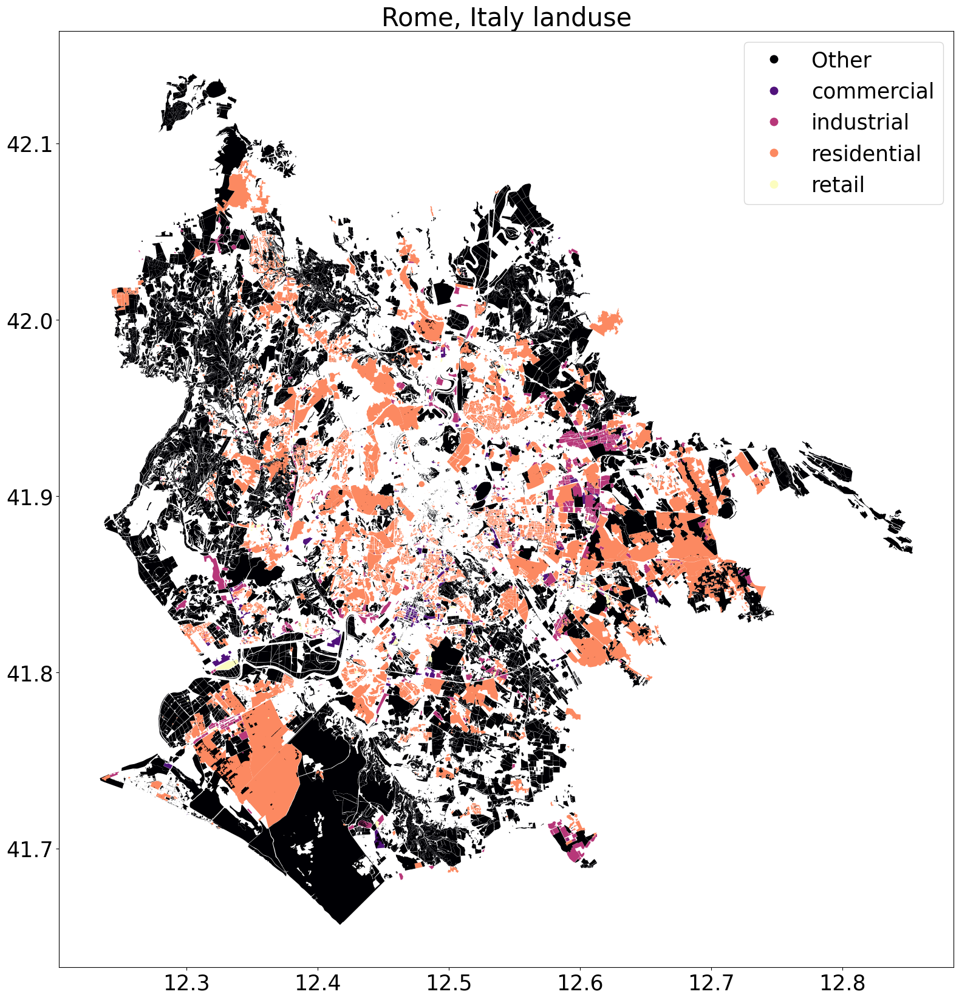

In [88]:
#plot node in landuse
fig, ax = plt.subplots(figsize=(20,20))
landuse.plot(ax=ax, column = 'category', legend=True, cmap='magma')
plt.title(f'{PLACE_NAME} landuse')
plt.show()

In [89]:
#create a copy of landuse drop everything except Category and geometry
landuse_cat = landuse[['category', 'geometry']].copy()

In [90]:
import shapely.speedups
shapely.speedups.enable()

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3808896212.py:2: DeprecationWarning: This function has no longer any effect, and will be removed in a future release. Starting with Shapely 2.0, equivalent speedups are always available
  shapely.speedups.enable()


In [91]:
masks_land_use = []
for i in tqdm(range(0,city_polyframe_lat_long.shape[0])):
    pip_mask = landuse_cat.within(city_polyframe_lat_long.loc[i, 'geometry']) 
    masks_land_use.append(pip_mask)
    assert pip_mask.shape[0] == landuse_cat.shape[0]

100%|██████████| 5649/5649 [00:05<00:00, 1115.16it/s]


In [92]:
land_labels = []
for i in range(0,city_polyframe_lat_long.shape[0]):
    if landuse_cat[masks_land_use[i]].category.value_counts().isnull().all() == True:
        land_labels.append('Other')
    else:
        land_labels.append(landuse_cat[masks_land_use[i]].category.value_counts().index[0])

In [95]:
rome_polyframe_lat_long_new['landuse'] = land_labels

In [96]:
rome_polyframe_lat_long_new.landuse.value_counts()

landuse
Other          5122
residential     407
industrial       83
commercial       26
retail           11
Name: count, dtype: int64

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3326680652.py:8: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


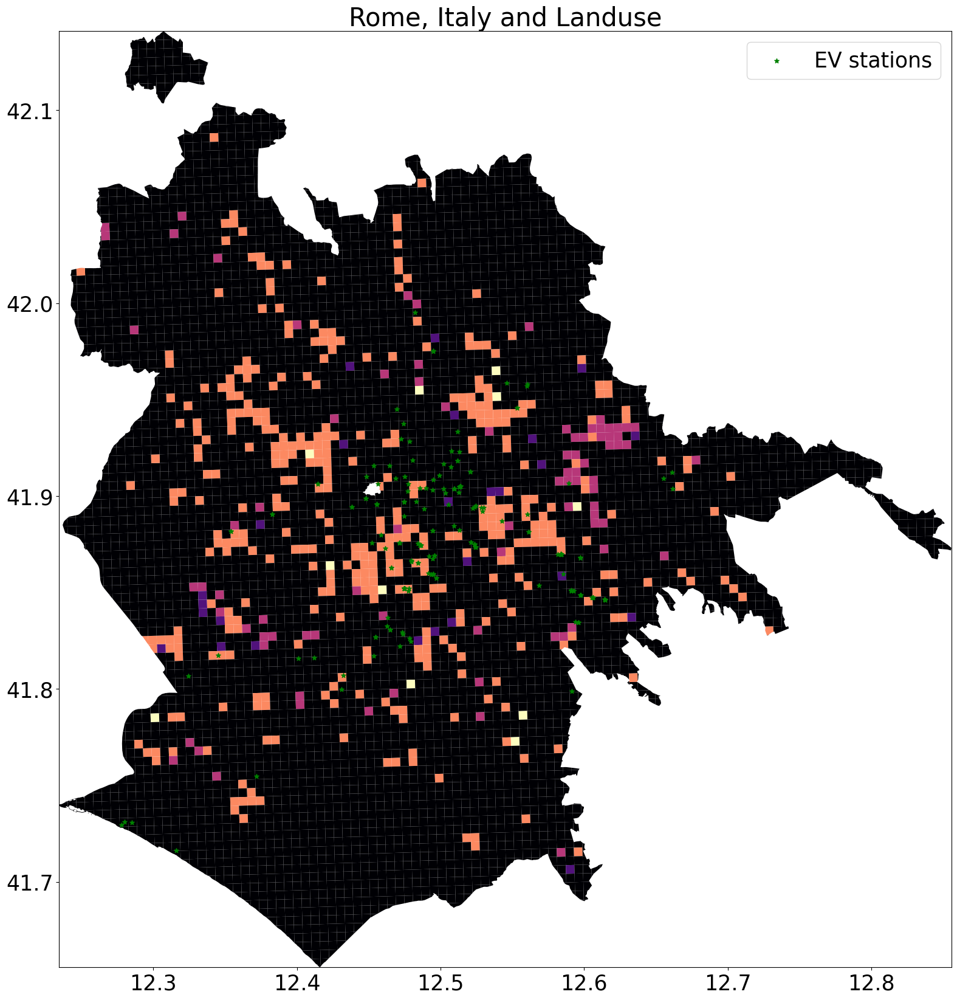

In [99]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'landuse', legend=False, cmap='magma')
# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=30, marker='*', label='EV stations')
ax.legend()
# add legend
plt.title(f'{PLACE_NAME} and Landuse')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
# ax.axis('off')30
plt.show()

## Road Connectivity

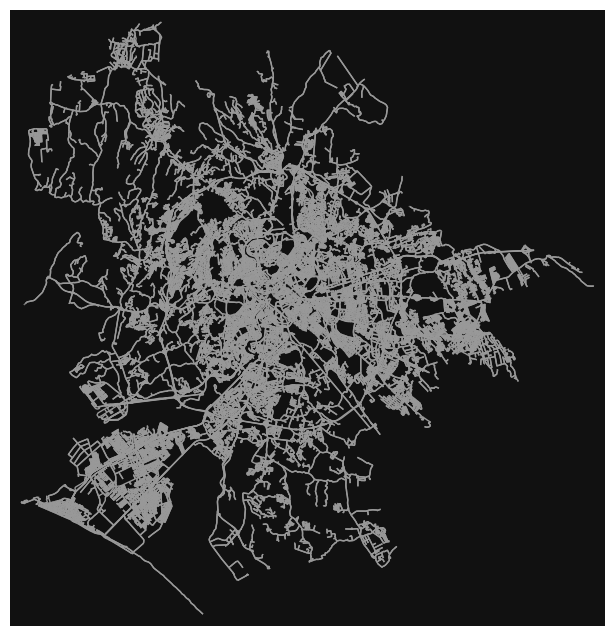

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [100]:
G = ox.graph_from_place(PLACE_NAME, network_type='drive')
ox.plot_graph(G, node_size= 0)

In [101]:
area,edges = ox.graph_to_gdfs(G)

In [102]:
#calculate number of edges and nodes for each grid
nodes = []
edges = []
density = []
for i in tqdm(range(0,city_polyframe_lat_long.shape[0])):
    try: 
        poly = city_polyframe_lat_long.loc[i, 'geometry']
        G = ox.graph_from_polygon(poly, network_type='drive')
        nodes.append(len(list(G.nodes())))
        edges.append(len(list(G.edges())))
        density.append(nx.density(G))
    except:
        nodes.append(0)
        edges.append(0)
        density.append(0)

100%|██████████| 5649/5649 [1:24:30<00:00,  1.11it/s]


In [103]:
#add nodes, edges and density to the dataframe
rome_polyframe_lat_long_new['nodes'] = nodes
rome_polyframe_lat_long_new['edges'] = edges
rome_polyframe_lat_long_new['density'] = density

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3496988589.py:12: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


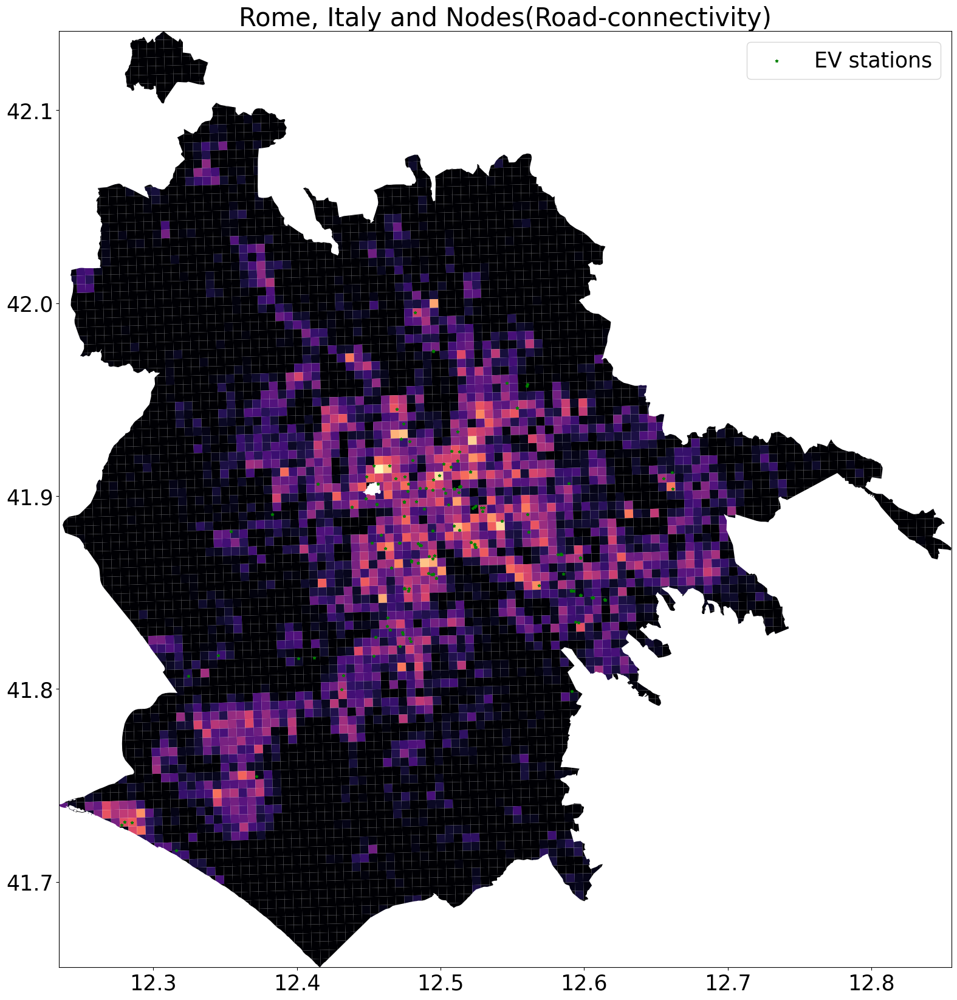

In [104]:
# relation between EVCSs and nodes
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

#nodes
fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'nodes', legend=False, cmap='magma')

# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=10, marker='*', label='EV stations')

ax.legend()
plt.title(f'{PLACE_NAME} and Nodes(Road-connectivity)')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.show()

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\843479457.py:11: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


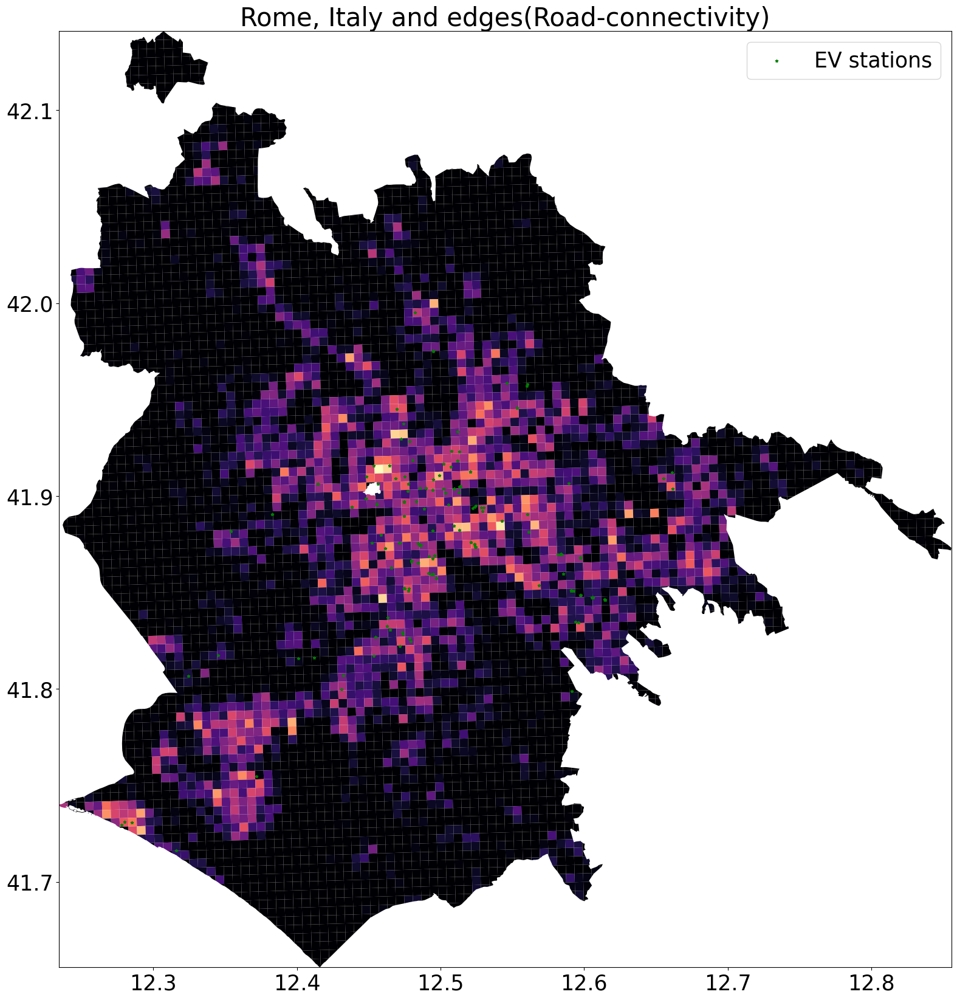

In [105]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

#edges
fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'edges', legend=False, cmap='magma')

# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=10, marker='*', label='EV stations')

ax.legend()
plt.title(f'{PLACE_NAME} and edges(Road-connectivity)')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.show()

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\25415402.py:11: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


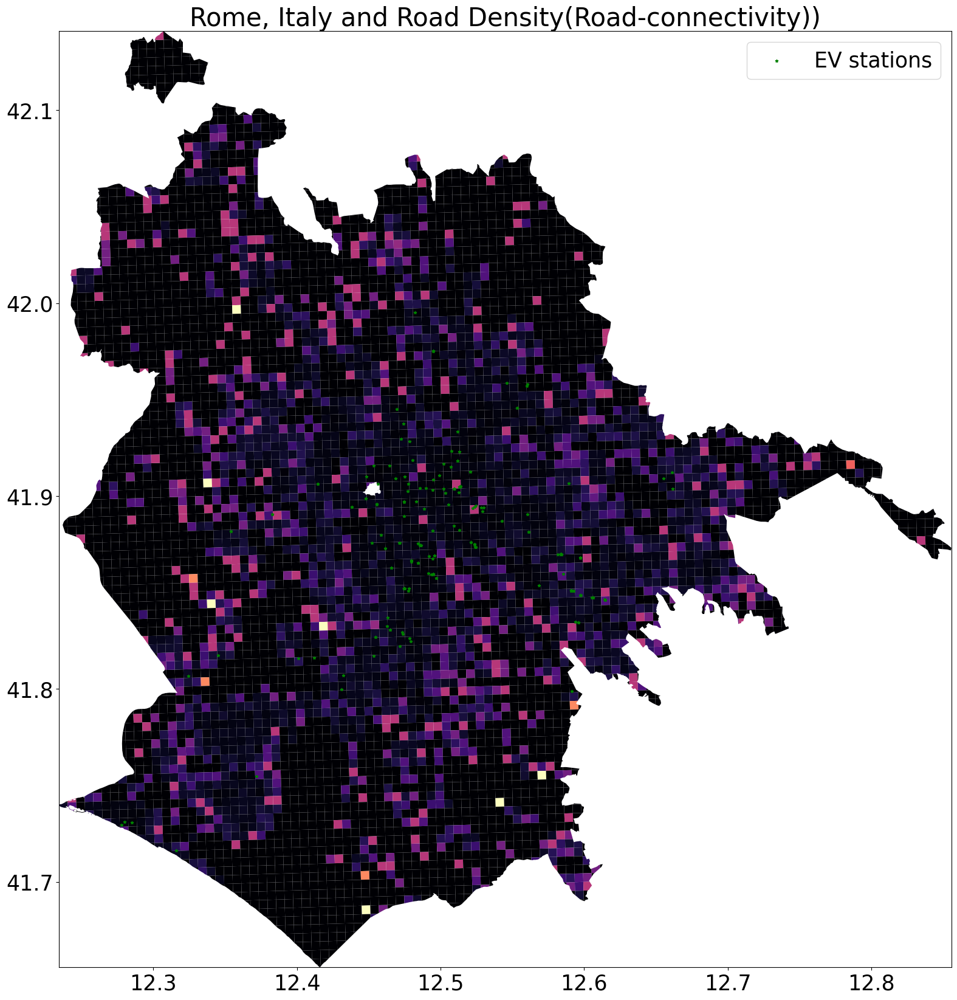

In [106]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

#density
fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'density', legend=False, cmap='magma')

# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=10, marker='*', label='EV stations')

ax.legend()
plt.title(f'{PLACE_NAME} and Road Density(Road-connectivity))')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.show()

## POIs

In [ ]:
import osmnx as ox
import pandas as pd
from tqdm import tqdm

def count_features_in_grids(place_name, features, city_polyframe, dataframe_name):
    for feature_key, feature_list in features.items():
        for feature in feature_list:
            try:
                # Fetch geometries from OpenStreetMap
                geometries = ox.geometries_from_place(
                    place_name,
                    {feature_key: feature}
                )
                # Export to CSV if geometries are found
                if not geometries.empty:
                    geometries.to_csv(f"D:/charging_stations/task2/dataset/Rome-{feature}.csv")

                    # Create masks for each grid
                    masks = []
                    for i in tqdm(range(0, city_polyframe.shape[0]), desc=f"Processing masks for {feature}"):
                        pip_mask = geometries.within(city_polyframe.loc[i, 'geometry'])
                        masks.append(pip_mask)

                    # Count features in each grid
                    feature_counts = []
                    for i in tqdm(range(0, city_polyframe.shape[0]), desc=f"Counting {feature}"):
                        feature_counts.append(geometries[masks[i]].shape[0])

                    # Add counts to the dataframe
                    dataframe_name[f'{feature}_count'] = feature_counts
                else:
                    print(f"No data found for {feature_key}='{feature}' in {place_name}.")
            except Exception as e:
                print(f"Failed to process {feature_key}='{feature}' in {place_name}: {str(e)}")

In [166]:
features = {
    'amenity': ['school', 'university', 'restaurant', 'place_of_worship', 
                'community_centre', 'townhall', 'parking', 'library'],
    'leisure': ['park', 'cinema'],
    'building': ['commercial', 'government', 'civic', 'retail']
}

city_polyframe = rome_polyframe_lat_long_new

count_features_in_grids(PLACE_NAME, features, city_polyframe, rome_polyframe_lat_long_new)

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting school: 100%|██████████| 5649/5649 [00:02<00:00, 2749.47it/s]
C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting university

Failed to process leisure='cinema' in Rome, Italy: No data elements in server response. Check log and query location/tags.


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting commercial: 100%|██████████| 5649/5649 [00:02<00:00, 1953.31it/s]
C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting govern

In [169]:
rome_polyframe_lat_long_new.head().T

,0,1,2,3,4
geometry,"POLYGON ((12.2344669 41.740046099999994, 12.23...",POLYGON ((12.238081281163069 41.74102481112229...,POLYGON ((12.240350100061367 41.74181902017413...,POLYGON ((12.246334913662437 41.74122305606923...,"POLYGON ((12.24468216472142 41.73670731642376,..."
EV_stations_counts,0,0,0,0,0
EV_stations_geomery,[],[],[],[],[]
parking_count,0,0,0,3,0
parking_types,{},{},{},"{'multi-storey': 1, 'surface': 1}",{}
restaurant_count,0,0,0,0,0
library_count,0,0,0,0,0
university_count,0,0,0,0,0
school_count,0,0,0,0,0
park_count,0,0,0,0,0


## Traffic

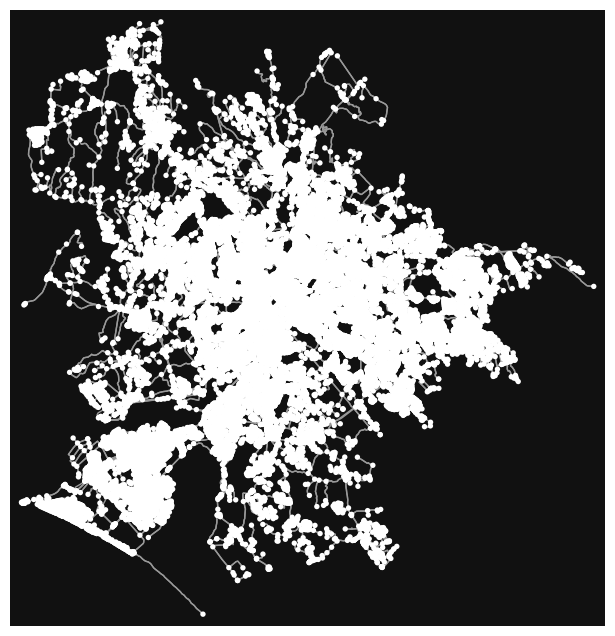

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [167]:
# Fetch road network data
rome_graph = ox.graph_from_place(PLACE_NAME, network_type='drive')

# Visualize the road network
ox.plot_graph(rome_graph)